Библиотеки

In [14]:
import torch
import matplotlib.pyplot as plt
from PIL import Image
from torchvision import transforms
from olimp.processing import fft_conv
from olimp.precompensation.nn.dataset.psf_gauss import PsfGaussDataset
from ballfish.distribution import DistributionParams
import os
import numpy as np2


Наложение шума и фрт на изображениями


Обработка изображения: 4.1.08.tiff
0

Генерация ФРТ 1 для 4.1.08.tiff
Добавление шума со стандартным отклонением 0.01


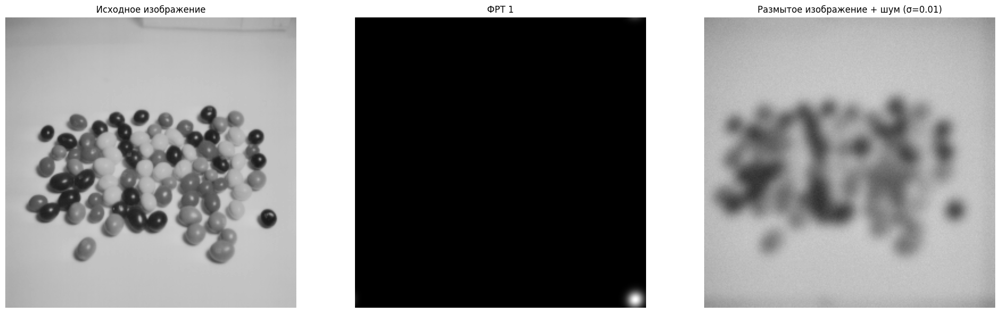

Добавление шума со стандартным отклонением 0.05


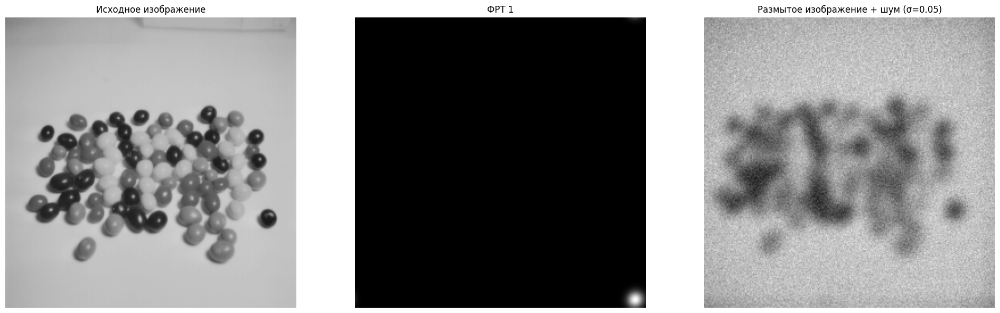

Добавление шума со стандартным отклонением 0.1


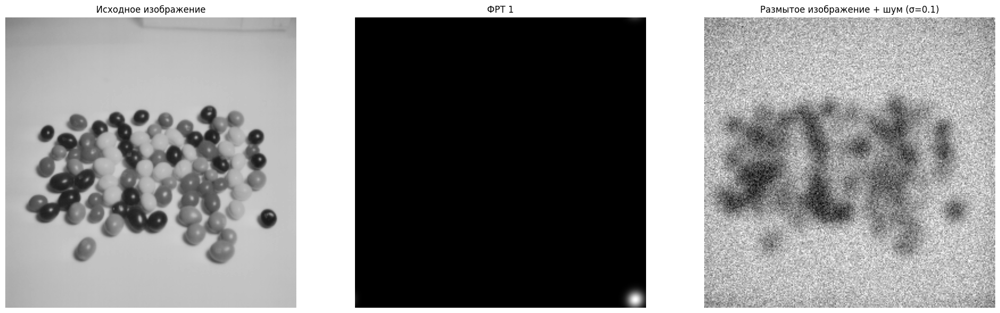


Генерация ФРТ 2 для 4.1.08.tiff
Добавление шума со стандартным отклонением 0.01


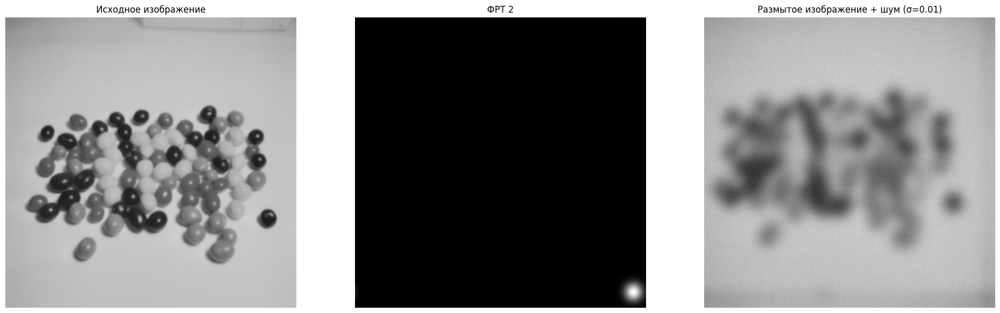

Добавление шума со стандартным отклонением 0.05


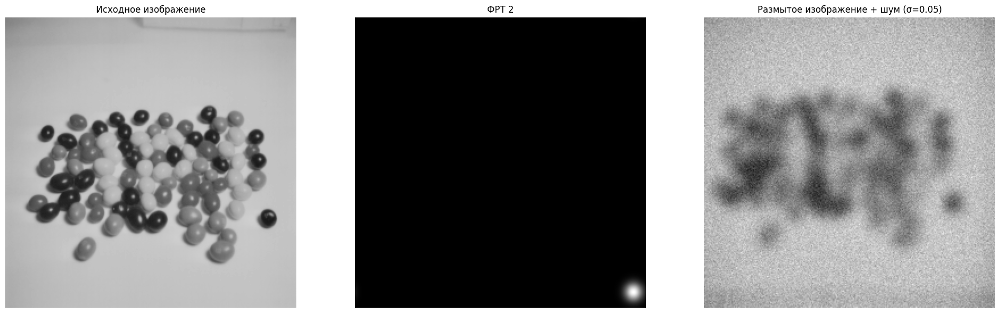

Добавление шума со стандартным отклонением 0.1


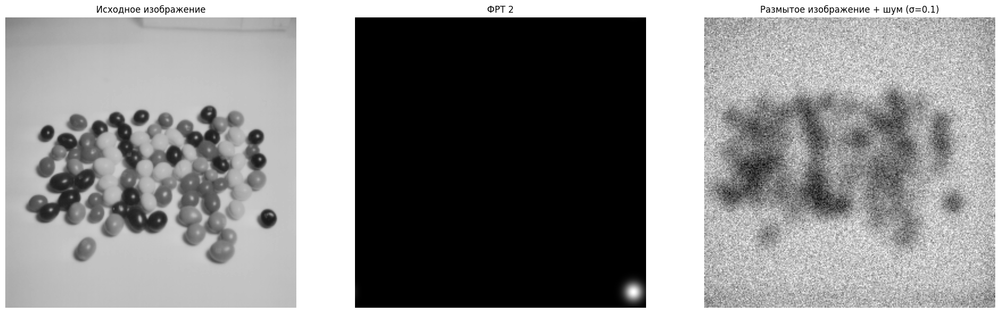


Генерация ФРТ 3 для 4.1.08.tiff
Добавление шума со стандартным отклонением 0.01


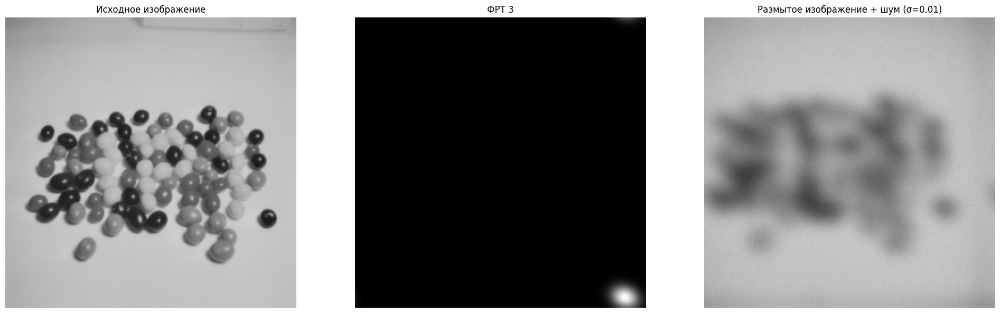

Добавление шума со стандартным отклонением 0.05


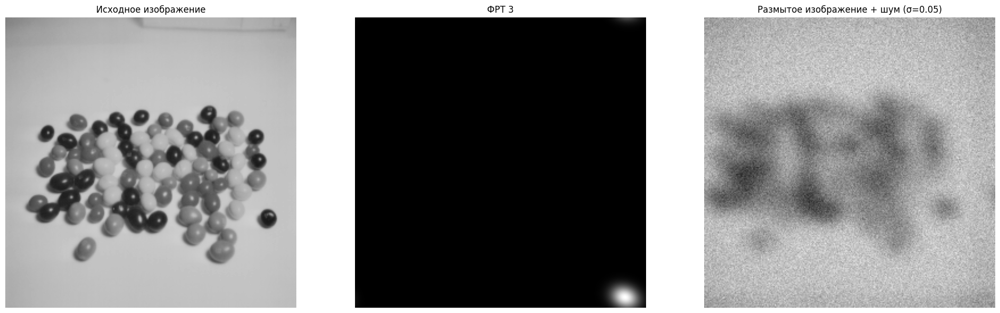

Добавление шума со стандартным отклонением 0.1


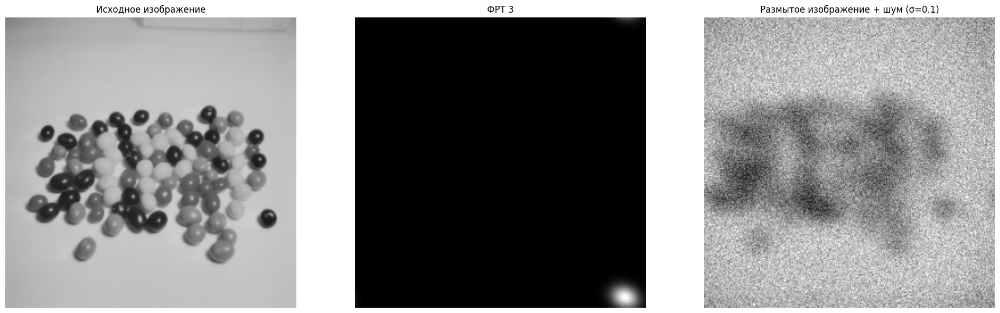


Генерация ФРТ 4 для 4.1.08.tiff
Добавление шума со стандартным отклонением 0.01


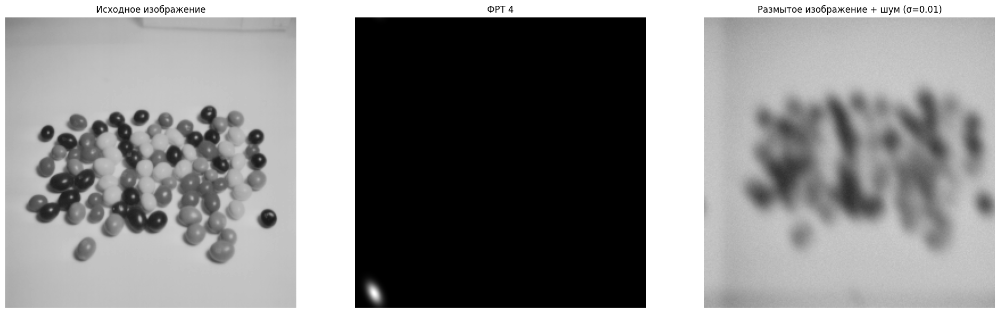

Добавление шума со стандартным отклонением 0.05


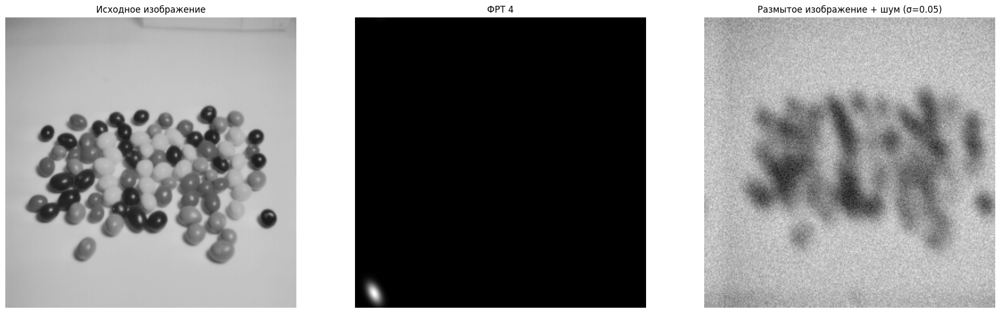

Добавление шума со стандартным отклонением 0.1


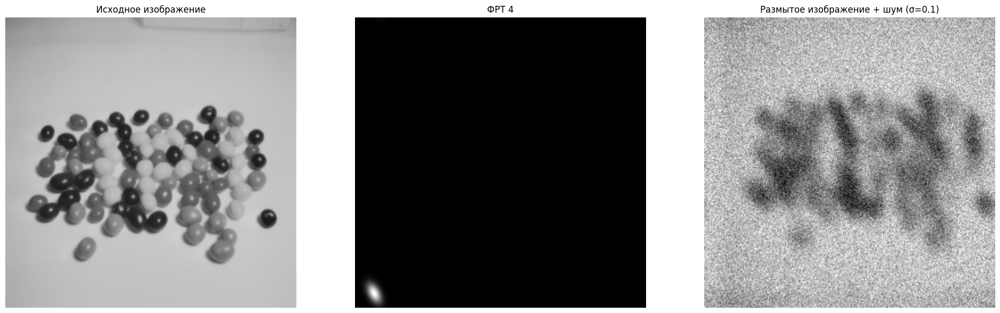


Обработка изображения: 5.1.12.tiff
1

Генерация ФРТ 1 для 5.1.12.tiff
Добавление шума со стандартным отклонением 0.01


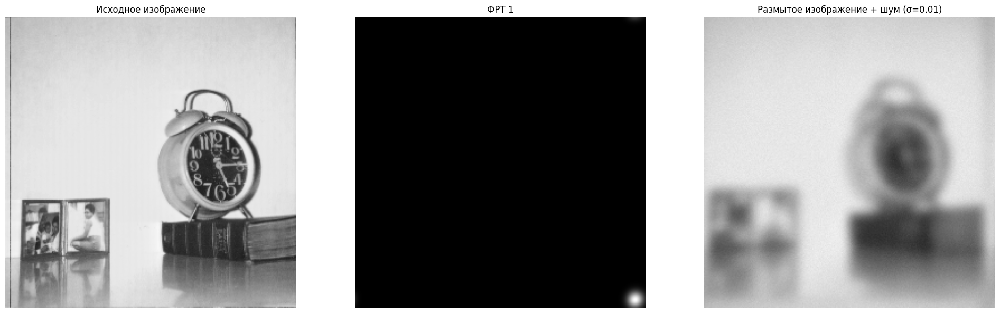

Добавление шума со стандартным отклонением 0.05


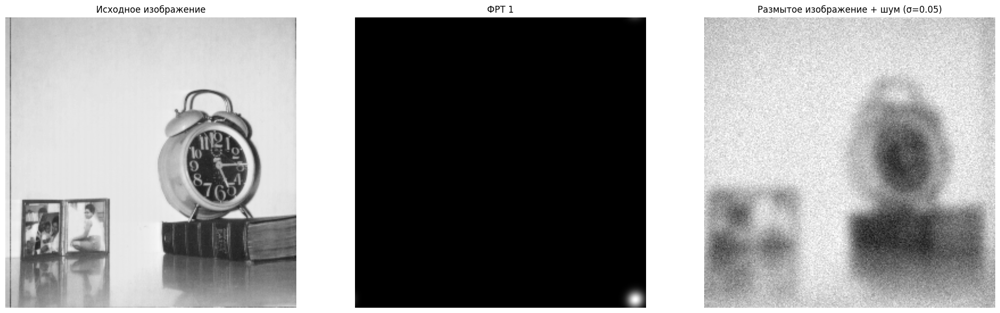

Добавление шума со стандартным отклонением 0.1


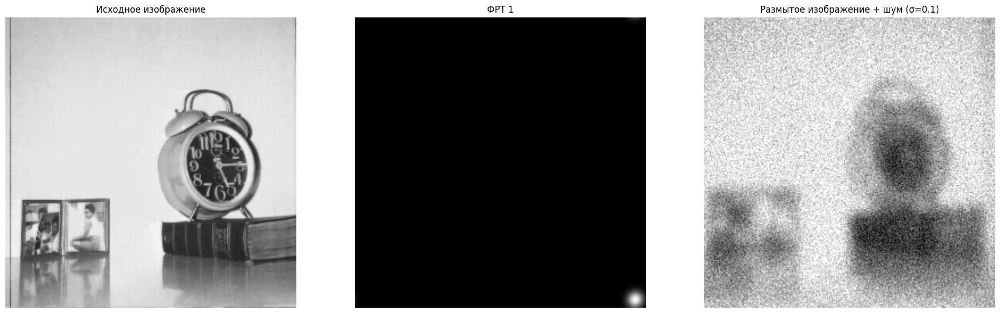


Генерация ФРТ 2 для 5.1.12.tiff
Добавление шума со стандартным отклонением 0.01


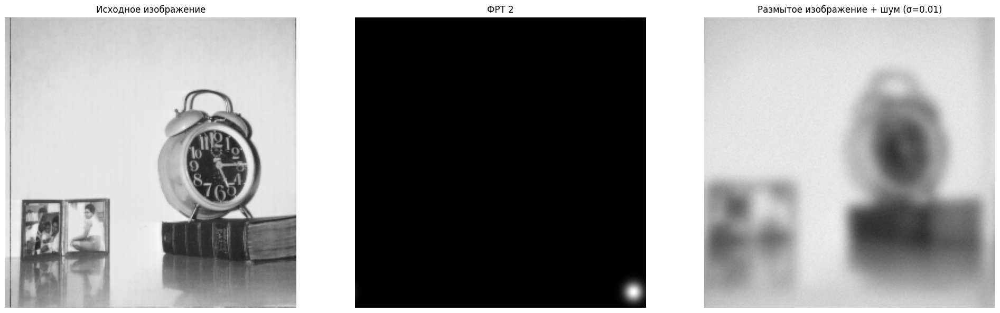

Добавление шума со стандартным отклонением 0.05


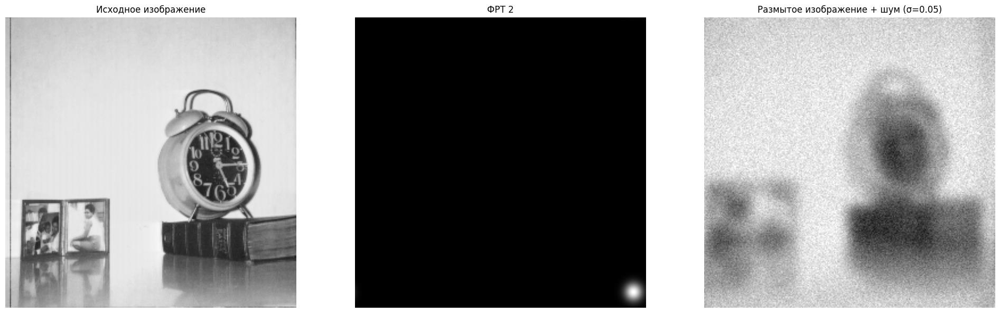

Добавление шума со стандартным отклонением 0.1


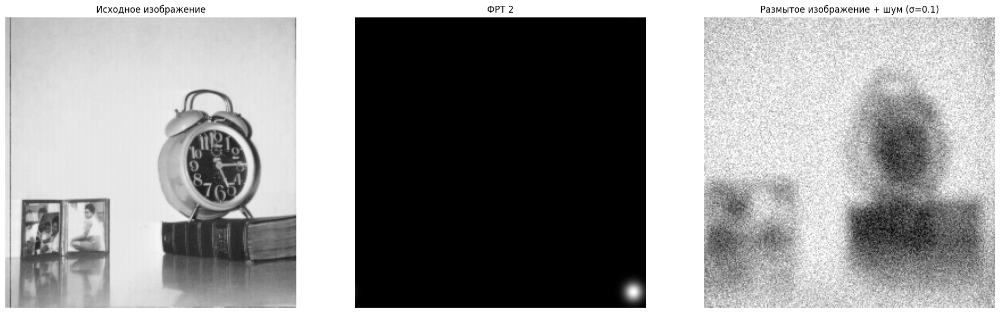


Генерация ФРТ 3 для 5.1.12.tiff
Добавление шума со стандартным отклонением 0.01


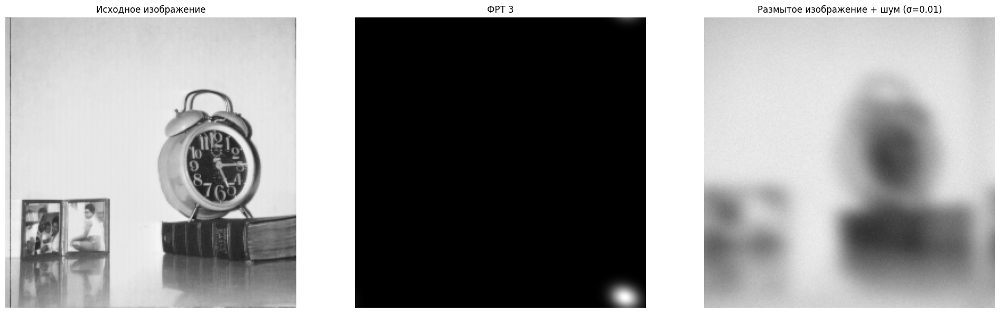

Добавление шума со стандартным отклонением 0.05


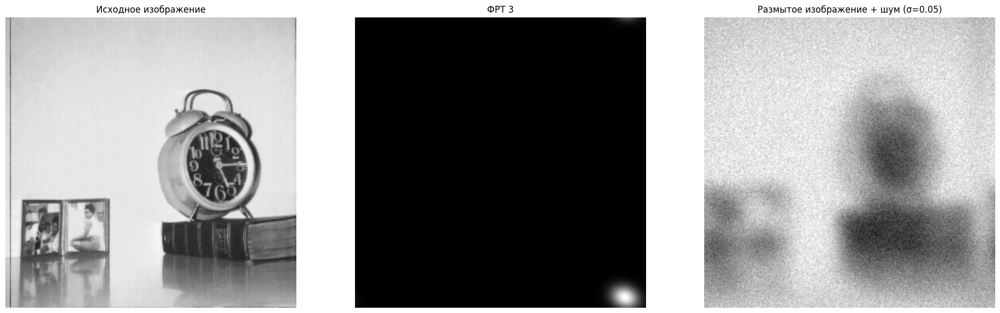

Добавление шума со стандартным отклонением 0.1


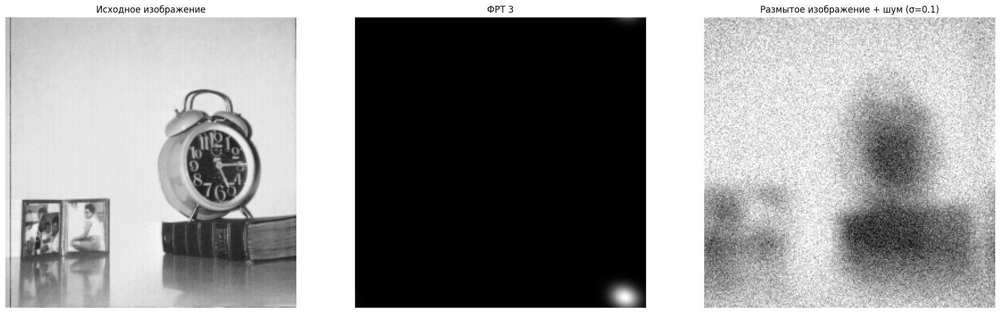


Генерация ФРТ 4 для 5.1.12.tiff
Добавление шума со стандартным отклонением 0.01


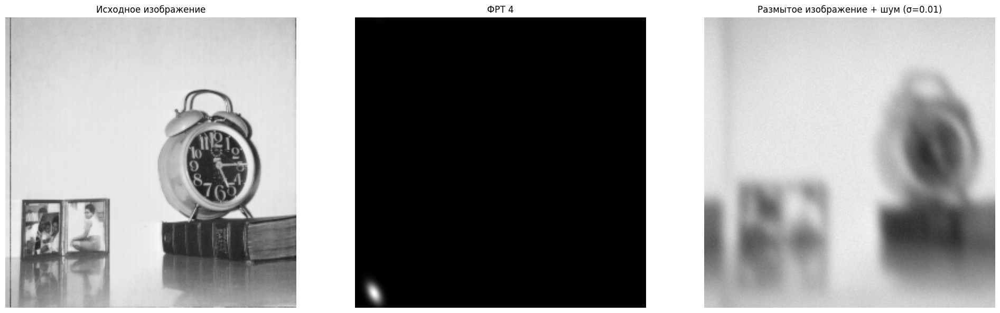

Добавление шума со стандартным отклонением 0.05


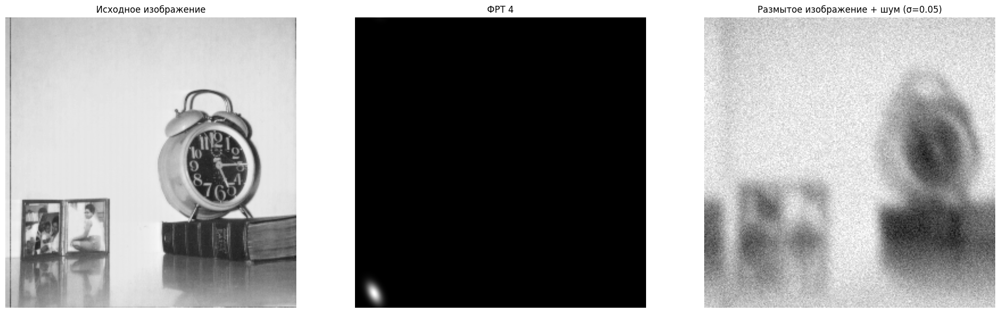

Добавление шума со стандартным отклонением 0.1


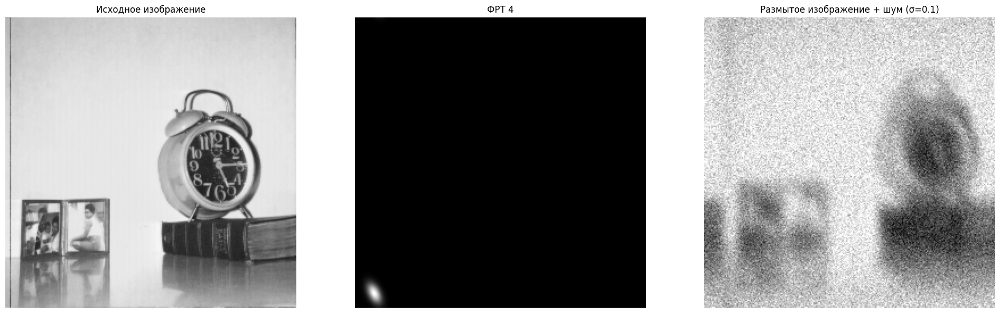


Обработка изображения: house.tiff
2

Генерация ФРТ 1 для house.tiff
Добавление шума со стандартным отклонением 0.01


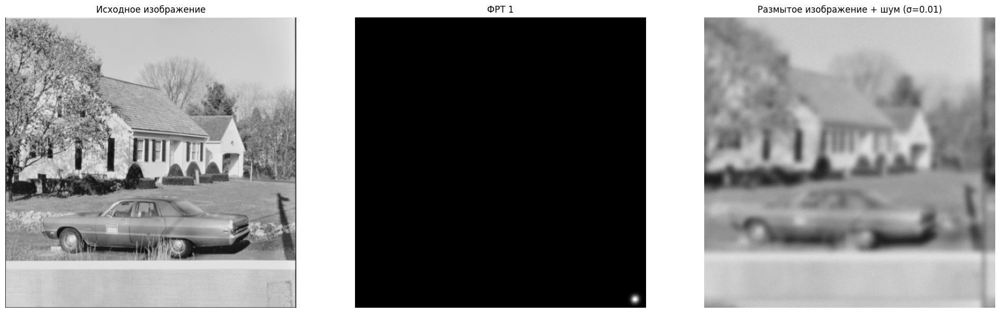

Добавление шума со стандартным отклонением 0.05


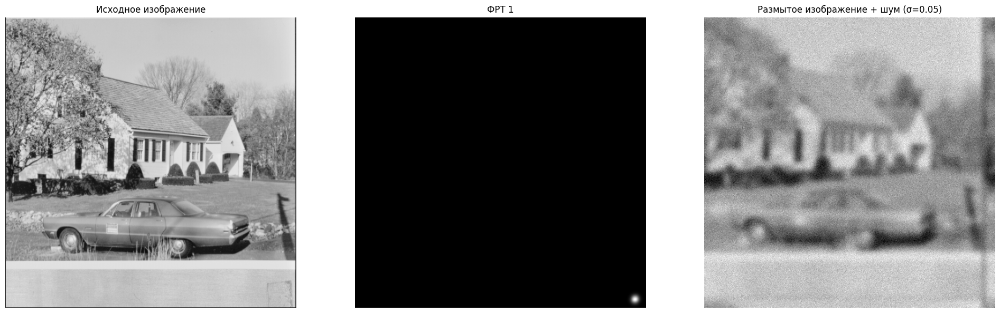

Добавление шума со стандартным отклонением 0.1


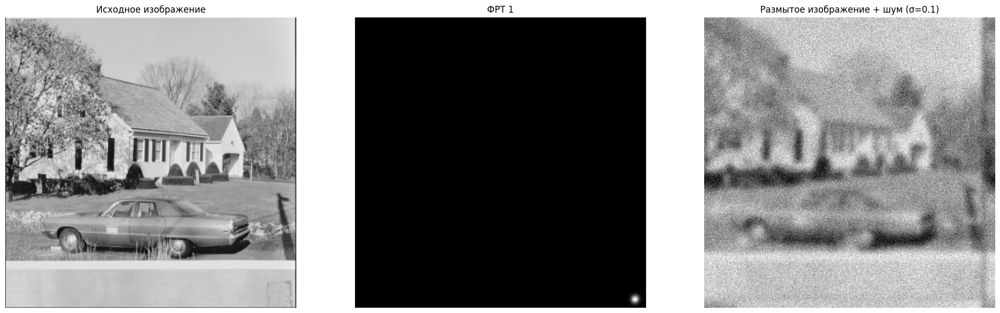


Генерация ФРТ 2 для house.tiff
Добавление шума со стандартным отклонением 0.01


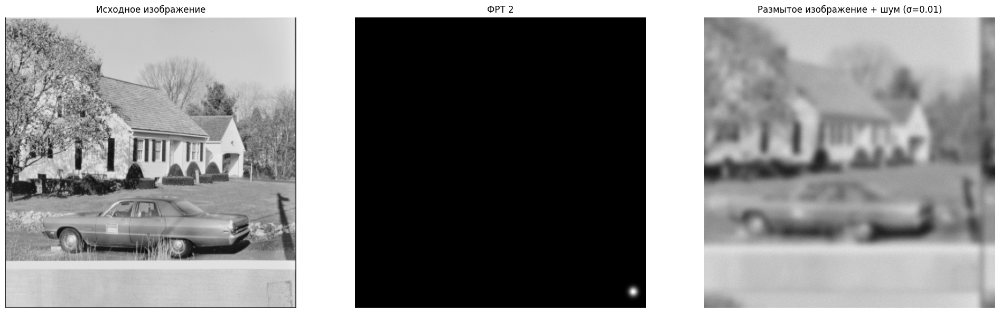

Добавление шума со стандартным отклонением 0.05


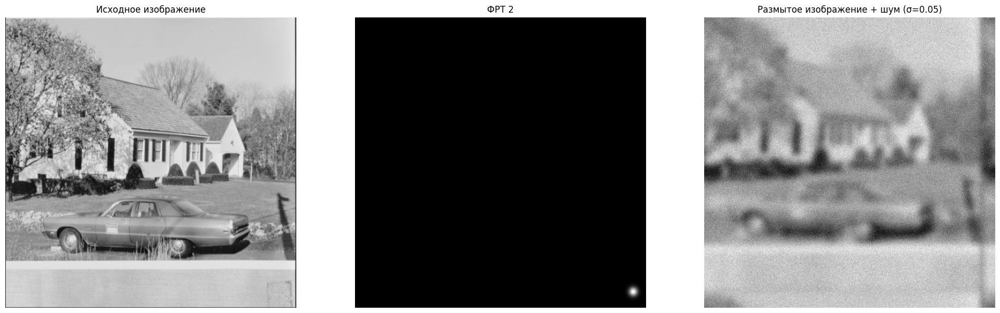

Добавление шума со стандартным отклонением 0.1


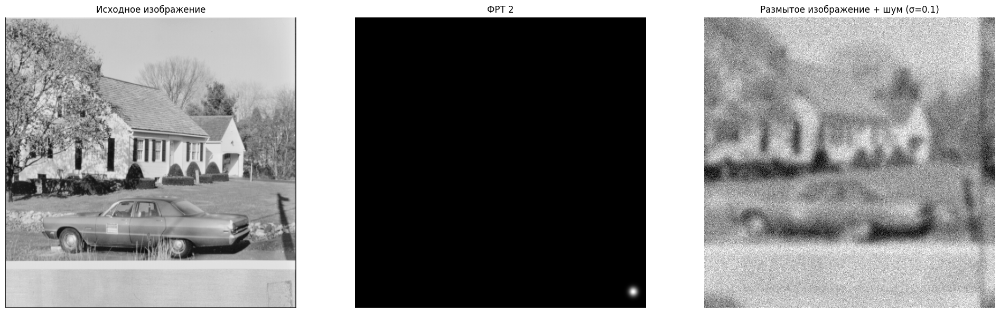


Генерация ФРТ 3 для house.tiff
Добавление шума со стандартным отклонением 0.01


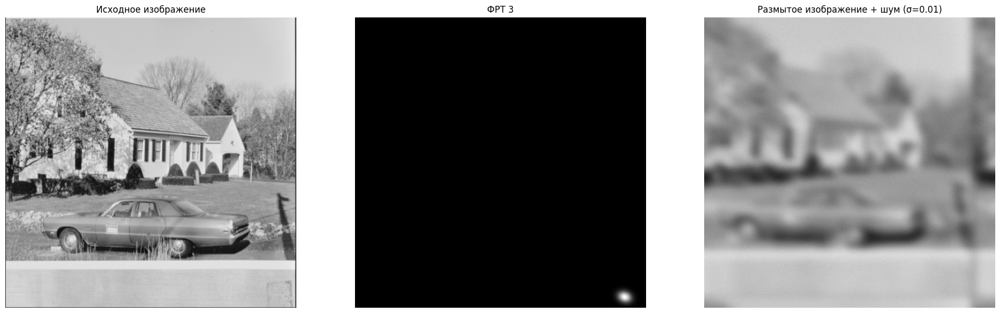

Добавление шума со стандартным отклонением 0.05


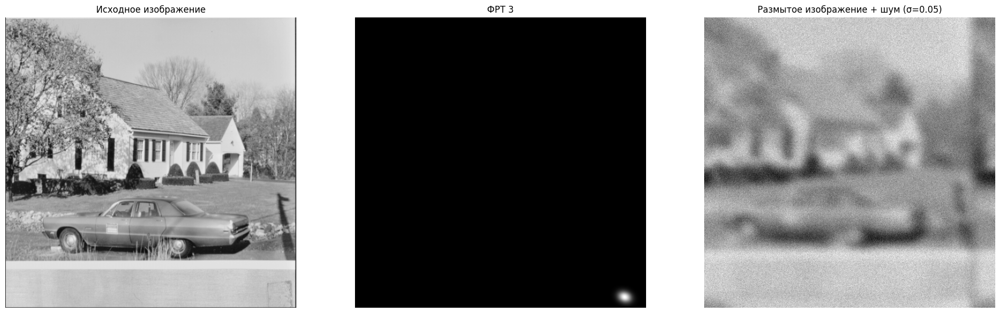

Добавление шума со стандартным отклонением 0.1


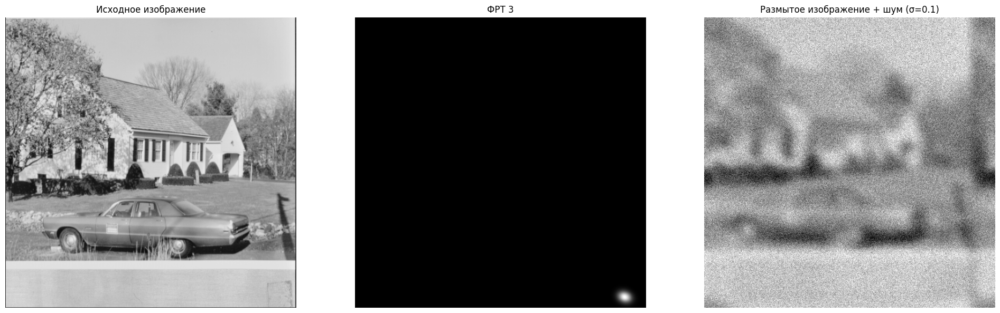


Генерация ФРТ 4 для house.tiff
Добавление шума со стандартным отклонением 0.01


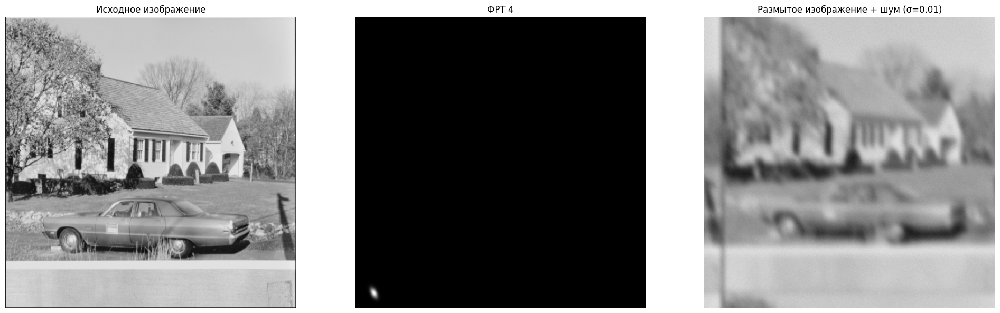

Добавление шума со стандартным отклонением 0.05


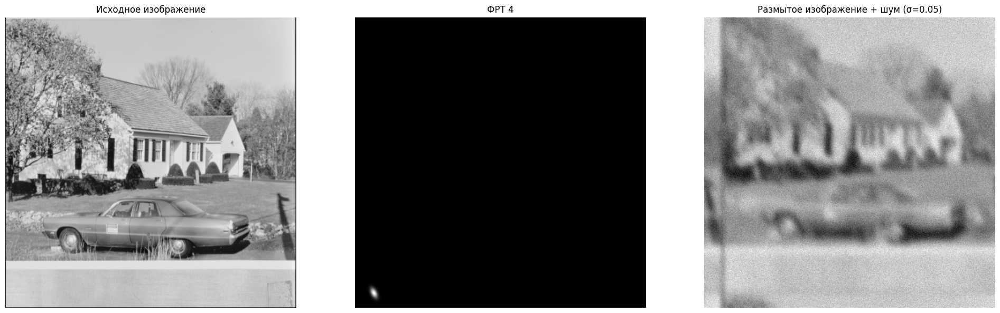

Добавление шума со стандартным отклонением 0.1


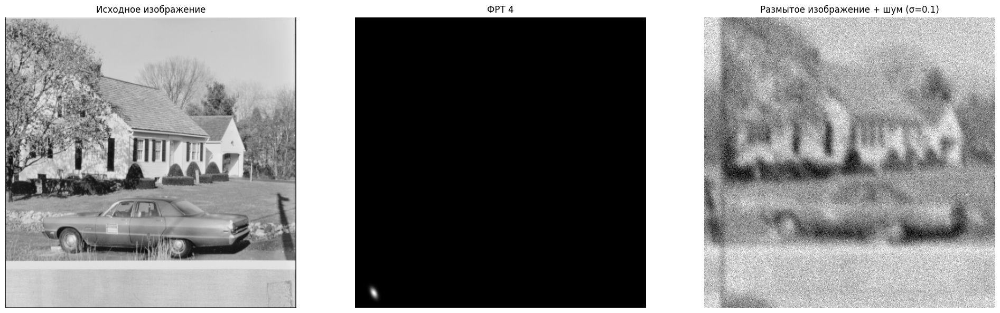


Обработка изображения: ruler.512.tiff
3

Генерация ФРТ 1 для ruler.512.tiff
Добавление шума со стандартным отклонением 0.01


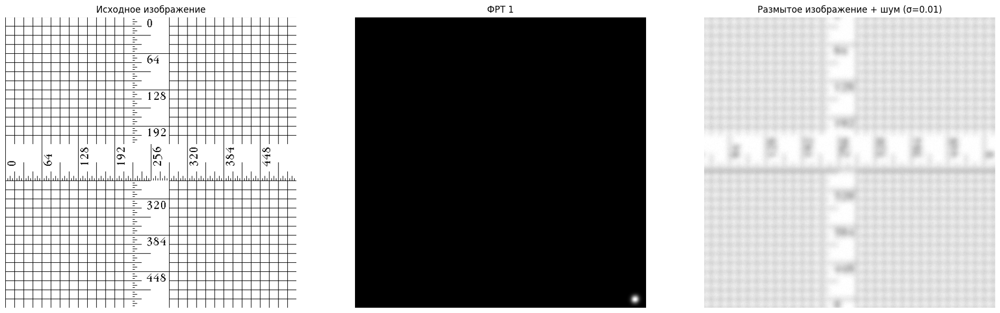

Добавление шума со стандартным отклонением 0.05


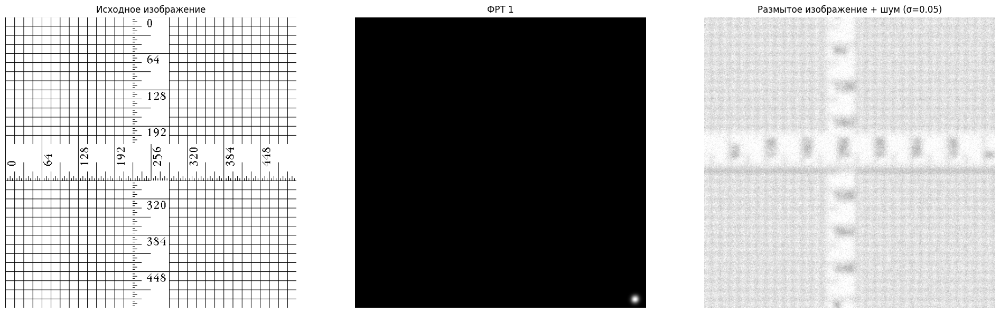

Добавление шума со стандартным отклонением 0.1


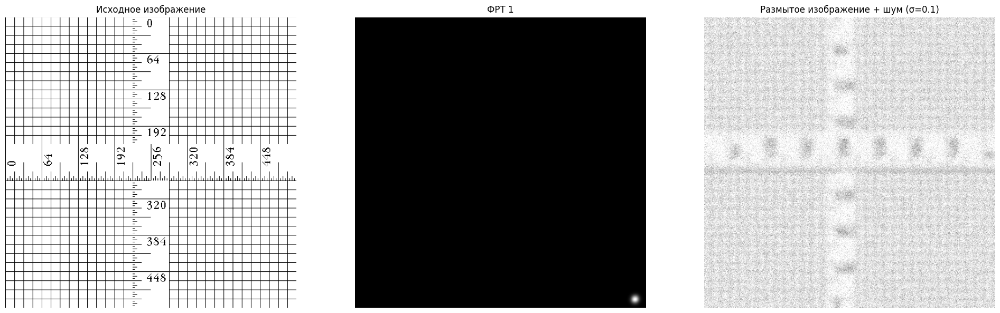


Генерация ФРТ 2 для ruler.512.tiff
Добавление шума со стандартным отклонением 0.01


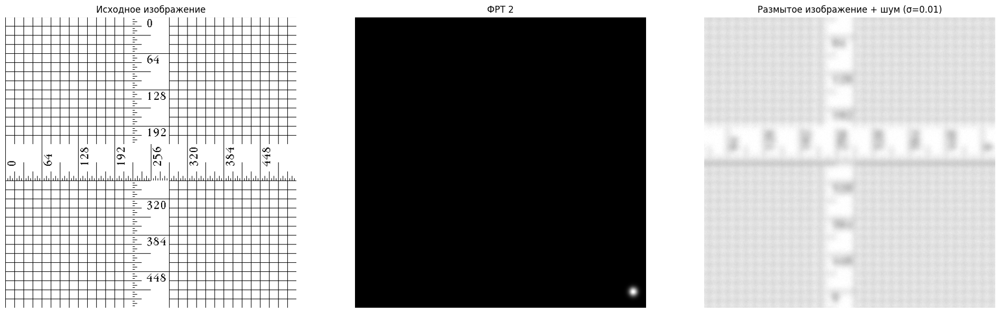

Добавление шума со стандартным отклонением 0.05


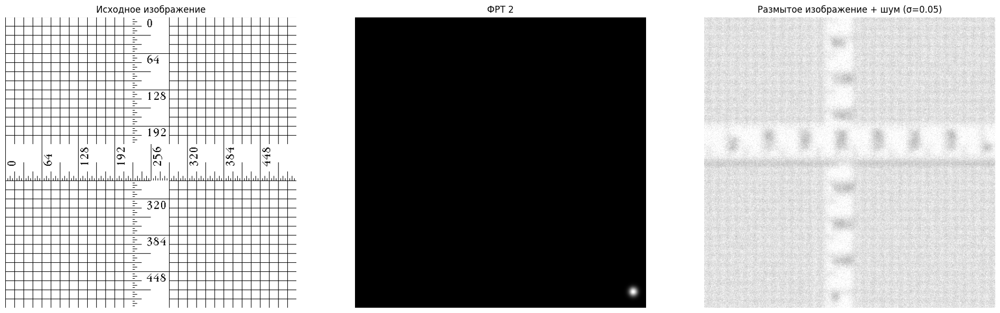

Добавление шума со стандартным отклонением 0.1


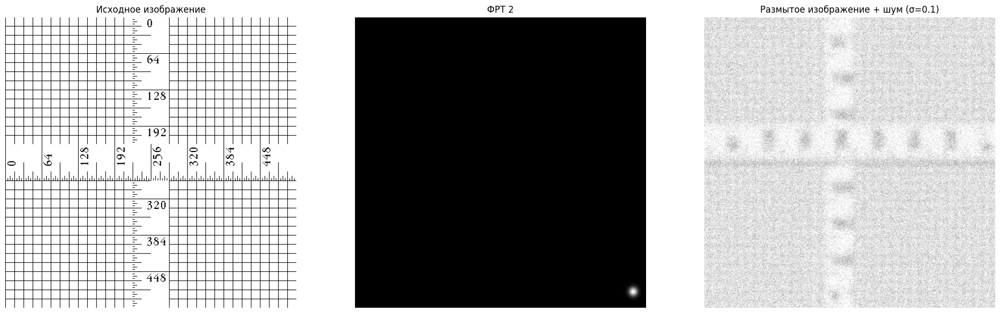


Генерация ФРТ 3 для ruler.512.tiff
Добавление шума со стандартным отклонением 0.01


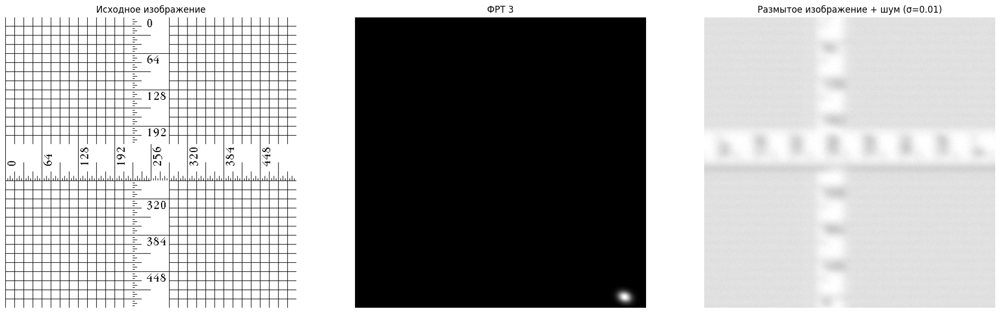

Добавление шума со стандартным отклонением 0.05


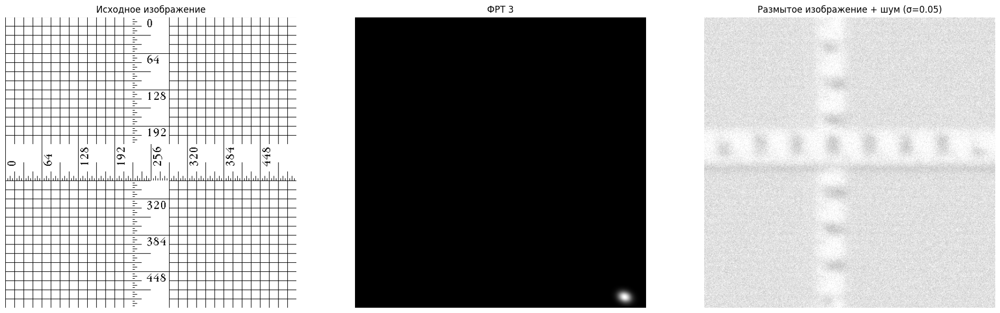

Добавление шума со стандартным отклонением 0.1


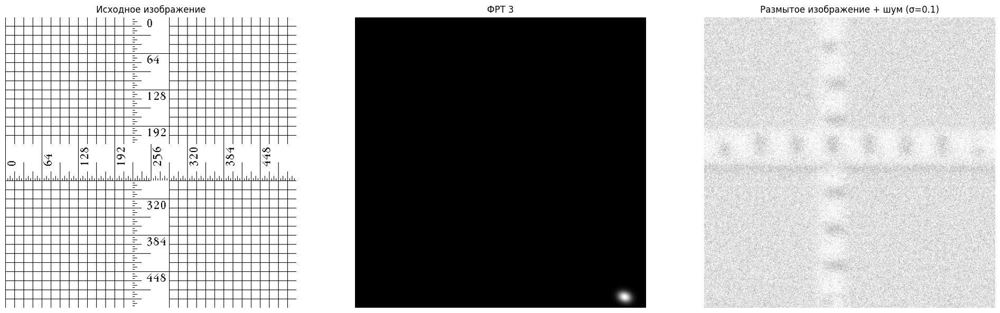


Генерация ФРТ 4 для ruler.512.tiff
Добавление шума со стандартным отклонением 0.01


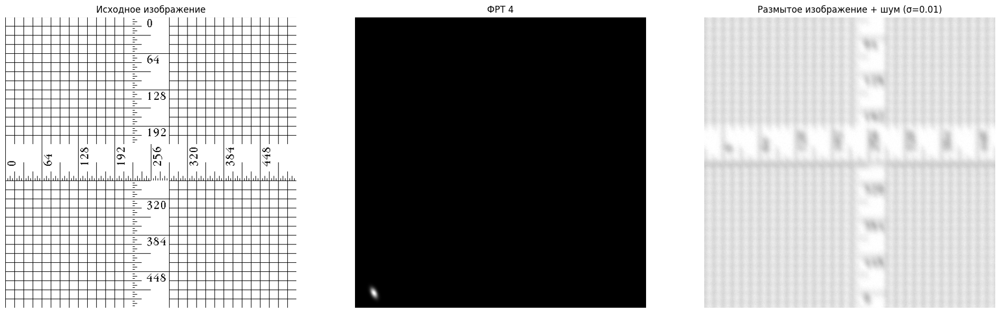

Добавление шума со стандартным отклонением 0.05


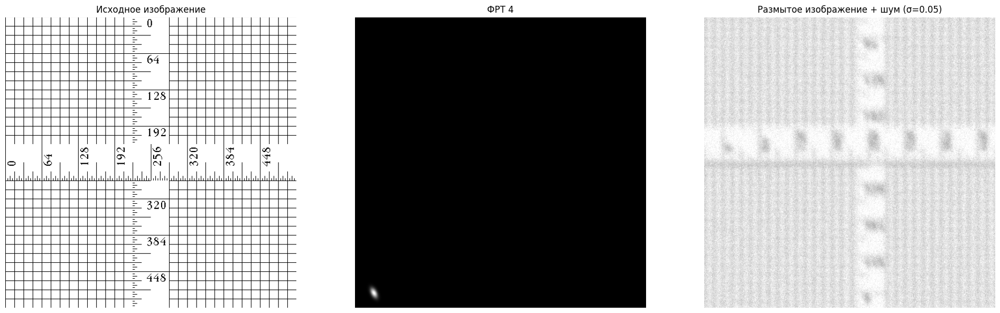

Добавление шума со стандартным отклонением 0.1


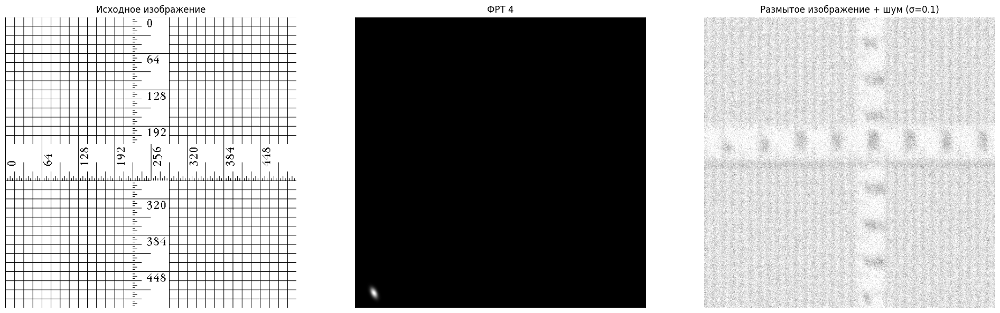


Сгенерировано 48 троек изображений


In [21]:

def load_and_preprocess_image(image_path):
    img = Image.open(image_path).convert("L")
    transform = transforms.Compose([
        transforms.ToTensor(),
        transforms.ConvertImageDtype(torch.float32)
    ])
    return transform(img).squeeze(0)

def prepare_kernel(kernel):
    """Подготовка ядра для FFT свертки"""
    if kernel.dim() == 3:
        kernel = kernel.squeeze(0)
    kernel = torch.fft.fftshift(kernel)
    return kernel / kernel.sum()

def add_noise(image, std):
    """Добавление гауссовского шума"""
    noise = torch.randn_like(image) * std
    noisy_image = image + noise
    return torch.clamp(noisy_image, 0, 1)

# Параметры
noise_levels = [0.01, 0.05, 0.1]
image_files = ['4.1.08.tiff', '5.1.12.tiff', 'house.tiff', 'ruler.512.tiff']
num_frts = 4
output_dir_1 = ['выходные_данные_1', 'выходные_данные_2', 'выходные_данные_3', 'выходные_данные_4']

for i in output_dir_1:
    os.makedirs(i, exist_ok=True)

# Фиксируем seed для воспроизводимости
torch.manual_seed(42)
np.random.seed(42)

trio_count = 0
n = -1

for img_file in image_files:
    print(f"\nОбработка изображения: {img_file}")
    img_path = os.path.join("data", img_file)
    img_tensor = load_and_preprocess_image(img_path)
    n = n + 1
    print(n)
    height, width = img_tensor.shape
    output_dir = output_dir_1[n]
    
    
    # Параметры для ФРТ
    center_x_params = {
        "name": "uniform", 
        "a": width/2 - width*0.1,
        "b": width/2 + width*0.1
    }
    center_y_params = {
        "name": "uniform", 
        "a": height/2 - height*0.1,
        "b": height/2 + height*0.1
    }
    theta_params = {
        "name": "uniform", 
        "a": 0.0,
        "b": 360.0
    }
    sigma_x_params = {
        "name": "uniform", 
        "a": 3.0,
        "b": 10.0
    }
    sigma_y_params = {
        "name": "uniform", 
        "a": 3.0,
        "b": 10.0
    }
    
    psf_dataset = PsfGaussDataset(
        width=width,
        height=height,
        center_x=center_x_params,
        center_y=center_y_params,
        theta=theta_params,
        sigma_x=sigma_x_params,
        sigma_y=sigma_y_params,
        size=num_frts,
        seed=42  # Фиксированный seed
    )
    
    for i in range(num_frts):
        print(f"\nГенерация ФРТ {i+1} для {img_file}")
        kernel = psf_dataset[i]
        kernel = prepare_kernel(kernel)
        
        blurred_img = fft_conv(img_tensor, kernel)
        
        for noise_std in noise_levels:
            trio_count += 1
            print(f"Добавление шума со стандартным отклонением {noise_std}")
            noisy_blurred_img = add_noise(blurred_img, noise_std)
            
            plt.figure(figsize=(20, 6))
            
            plt.subplot(131)
            plt.imshow(img_tensor.numpy(), cmap='gray', vmin=0, vmax=1)
            plt.title('Исходное изображение')
            plt.axis('off')
            
            plt.subplot(132)
            kernel_vis = kernel.numpy()
            kernel_vis = (kernel_vis - kernel_vis.min()) / (kernel_vis.max() - kernel_vis.min())
            plt.imshow(kernel_vis, cmap='gray')
            plt.title(f'ФРТ {i+1}')
            plt.axis('off')
            
            plt.subplot(133)
            plt.imshow(noisy_blurred_img.numpy(), cmap='gray', vmin=0, vmax=1)
            plt.title(f'Размытое изображение + шум (σ={noise_std})')
            plt.axis('off')
            
            plt.tight_layout()
            
            # Сохраняем и показываем
            output_path = os.path.join(
                output_dir, 
                f"{os.path.splitext(img_file)[0]}_frt{i+1}_noise{noise_std}.png"
            )
            plt.savefig(output_path, bbox_inches='tight', dpi=150)
            plt.show()
            plt.close()
            
            # Сохраняем тензоры
            torch.save({
                'original': img_tensor,
                'psf': kernel,
                'blurred_noisy': noisy_blurred_img,
                'noise_std': noise_std
            }, output_path.replace('.png', '.pt'))

print(f"\nСгенерировано {trio_count} троек изображений")

1 восстановление методом Ричардсона Люси


Обработка ruler.512_frt4_noise0.01.pt
Размерности тензоров:
Оригинал: torch.Size([512, 512])
ФРТ: torch.Size([512, 512])
Размытое: torch.Size([512, 512])
Выполнение деконволюции Ричардсона-Люси:
Итерация 5/500
Итерация 10/500
Итерация 15/500


/tmp/ipykernel_11364/48905147.py:171: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  data_dict = torch.load(os.path.join(output_dir, file))


Итерация 20/500
Итерация 25/500
Итерация 30/500
Итерация 35/500
Итерация 40/500
Итерация 45/500
Итерация 50/500
Итерация 55/500
Итерация 60/500
Итерация 65/500
Итерация 70/500
Итерация 75/500
Итерация 80/500
Итерация 85/500
Итерация 90/500
Итерация 95/500
Итерация 100/500
Итерация 105/500
Итерация 110/500
Итерация 115/500
Итерация 120/500
Итерация 125/500
Итерация 130/500
Итерация 135/500
Итерация 140/500
Итерация 145/500
Итерация 150/500
Итерация 155/500
Итерация 160/500
Итерация 165/500
Итерация 170/500
Итерация 175/500
Итерация 180/500
Итерация 185/500
Итерация 190/500
Итерация 195/500
Итерация 200/500
Итерация 205/500
Итерация 210/500
Итерация 215/500
Итерация 220/500
Итерация 225/500
Итерация 230/500
Итерация 235/500
Итерация 240/500
Итерация 245/500
Итерация 250/500
Итерация 255/500
Итерация 260/500
Итерация 265/500
Итерация 270/500
Итерация 275/500
Итерация 280/500
Итерация 285/500
Итерация 290/500
Итерация 295/500
Итерация 300/500
Итерация 305/500
Итерация 310/500
Итерация 315/

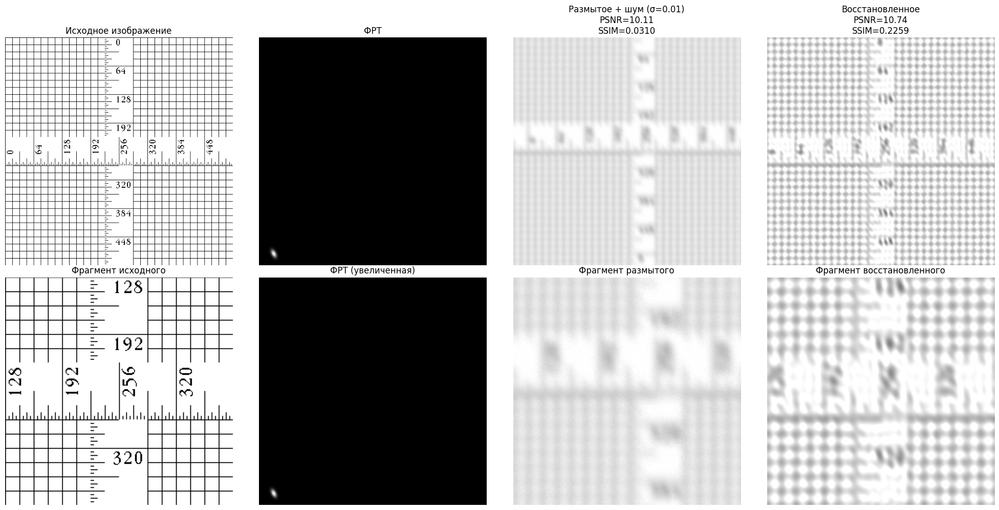


Обработка ruler.512_frt2_noise0.01.pt
Размерности тензоров:
Оригинал: torch.Size([512, 512])
ФРТ: torch.Size([512, 512])
Размытое: torch.Size([512, 512])
Выполнение деконволюции Ричардсона-Люси:
Итерация 5/500
Итерация 10/500
Итерация 15/500
Итерация 20/500
Итерация 25/500
Итерация 30/500
Итерация 35/500
Итерация 40/500
Итерация 45/500
Итерация 50/500
Итерация 55/500
Итерация 60/500
Итерация 65/500
Итерация 70/500
Итерация 75/500
Итерация 80/500
Итерация 85/500
Итерация 90/500
Итерация 95/500
Итерация 100/500
Итерация 105/500
Итерация 110/500
Итерация 115/500
Итерация 120/500
Итерация 125/500
Итерация 130/500
Итерация 135/500
Итерация 140/500
Итерация 145/500
Итерация 150/500
Итерация 155/500
Итерация 160/500
Итерация 165/500
Итерация 170/500
Итерация 175/500
Итерация 180/500
Итерация 185/500
Итерация 190/500
Итерация 195/500
Итерация 200/500
Итерация 205/500
Итерация 210/500
Итерация 215/500
Итерация 220/500
Итерация 225/500
Итерация 230/500
Итерация 235/500
Итерация 240/500
Итерация

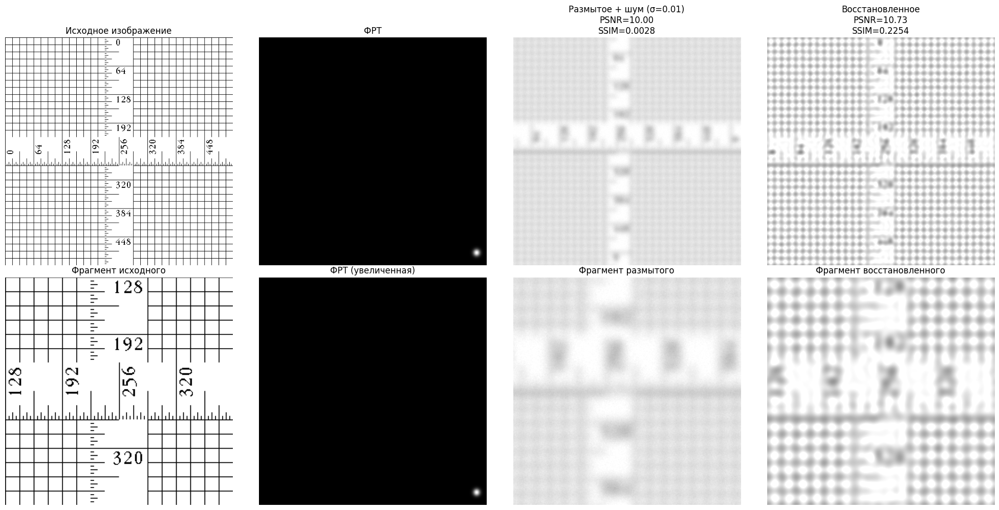


Обработка ruler.512_frt3_noise0.01.pt
Размерности тензоров:
Оригинал: torch.Size([512, 512])
ФРТ: torch.Size([512, 512])
Размытое: torch.Size([512, 512])
Выполнение деконволюции Ричардсона-Люси:
Итерация 5/500
Итерация 10/500
Итерация 15/500
Итерация 20/500
Итерация 25/500
Итерация 30/500
Итерация 35/500
Итерация 40/500
Итерация 45/500
Итерация 50/500
Итерация 55/500
Итерация 60/500
Итерация 65/500
Итерация 70/500
Итерация 75/500
Итерация 80/500
Итерация 85/500
Итерация 90/500
Итерация 95/500
Итерация 100/500
Итерация 105/500
Итерация 110/500
Итерация 115/500
Итерация 120/500
Итерация 125/500
Итерация 130/500
Итерация 135/500
Итерация 140/500
Итерация 145/500
Итерация 150/500
Итерация 155/500
Итерация 160/500
Итерация 165/500
Итерация 170/500
Итерация 175/500
Итерация 180/500
Итерация 185/500
Итерация 190/500
Алгоритм остановлен на итерации 193 из-за достижения заданной точности.


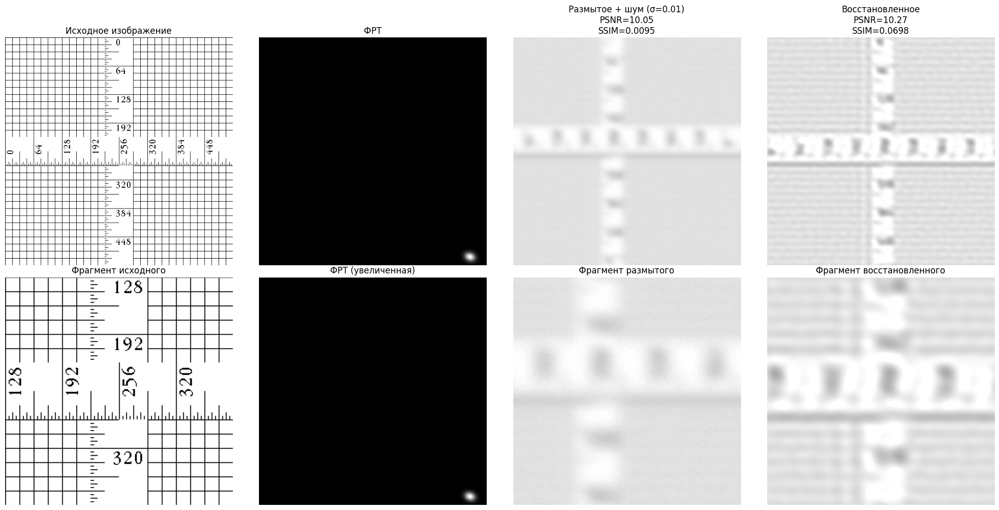


Обработка ruler.512_frt4_noise0.1.pt
Размерности тензоров:
Оригинал: torch.Size([512, 512])
ФРТ: torch.Size([512, 512])
Размытое: torch.Size([512, 512])
Выполнение деконволюции Ричардсона-Люси:
Итерация 5/500
Итерация 10/500
Алгоритм остановлен на итерации 14 из-за достижения заданной точности.


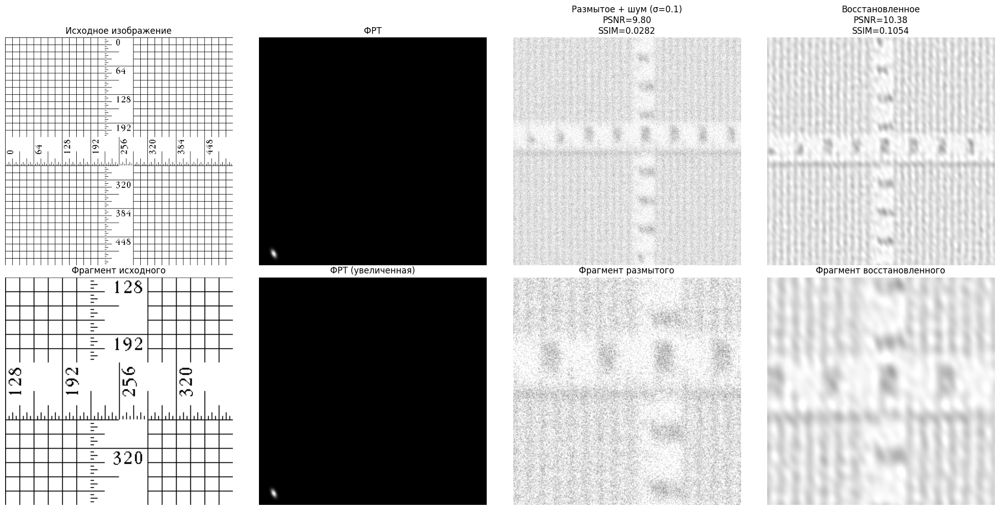


Обработка ruler.512_frt3_noise0.05.pt
Размерности тензоров:
Оригинал: torch.Size([512, 512])
ФРТ: torch.Size([512, 512])
Размытое: torch.Size([512, 512])
Выполнение деконволюции Ричардсона-Люси:
Итерация 5/500
Итерация 10/500
Итерация 15/500
Итерация 20/500
Итерация 25/500
Итерация 30/500
Итерация 35/500
Итерация 40/500
Итерация 45/500
Итерация 50/500
Итерация 55/500
Итерация 60/500
Итерация 65/500
Итерация 70/500
Итерация 75/500
Итерация 80/500
Итерация 85/500
Итерация 90/500
Итерация 95/500
Итерация 100/500
Итерация 105/500
Итерация 110/500
Итерация 115/500
Итерация 120/500
Итерация 125/500
Итерация 130/500
Итерация 135/500
Итерация 140/500
Итерация 145/500
Итерация 150/500
Итерация 155/500
Итерация 160/500
Итерация 165/500
Итерация 170/500
Итерация 175/500
Итерация 180/500
Итерация 185/500
Итерация 190/500
Итерация 195/500
Итерация 200/500
Итерация 205/500
Итерация 210/500
Итерация 215/500
Итерация 220/500
Итерация 225/500
Итерация 230/500
Итерация 235/500
Итерация 240/500
Итерация

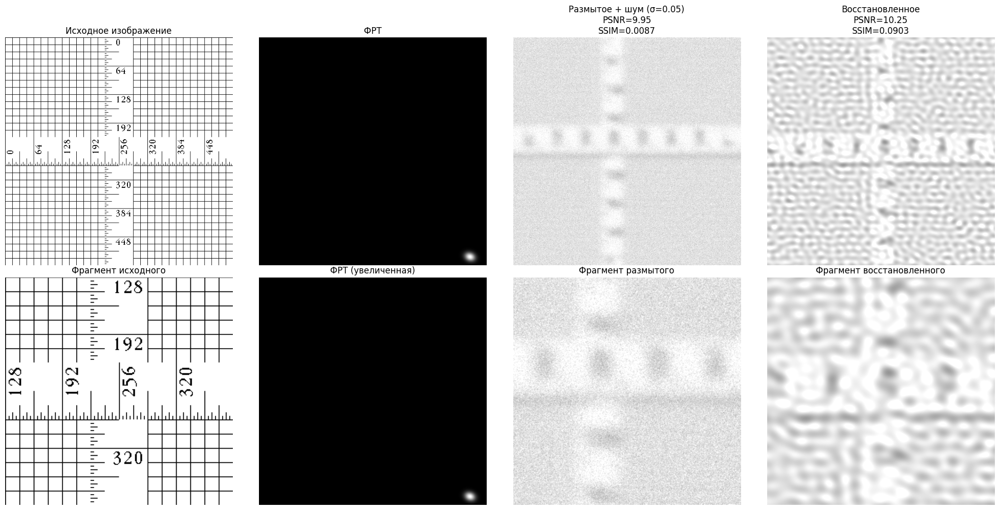


Обработка ruler.512_frt4_noise0.05.pt
Размерности тензоров:
Оригинал: torch.Size([512, 512])
ФРТ: torch.Size([512, 512])
Размытое: torch.Size([512, 512])
Выполнение деконволюции Ричардсона-Люси:
Итерация 5/500
Итерация 10/500
Итерация 15/500
Итерация 20/500
Итерация 25/500
Итерация 30/500
Итерация 35/500
Итерация 40/500
Итерация 45/500
Итерация 50/500
Итерация 55/500
Итерация 60/500
Итерация 65/500
Итерация 70/500
Итерация 75/500
Итерация 80/500
Итерация 85/500
Итерация 90/500
Итерация 95/500
Итерация 100/500
Итерация 105/500
Итерация 110/500
Итерация 115/500
Итерация 120/500
Итерация 125/500
Итерация 130/500
Итерация 135/500
Итерация 140/500
Итерация 145/500
Итерация 150/500
Итерация 155/500
Итерация 160/500
Итерация 165/500
Итерация 170/500
Итерация 175/500
Итерация 180/500
Итерация 185/500
Итерация 190/500
Итерация 195/500
Итерация 200/500
Итерация 205/500
Итерация 210/500
Итерация 215/500
Итерация 220/500
Итерация 225/500
Итерация 230/500
Итерация 235/500
Итерация 240/500
Итерация

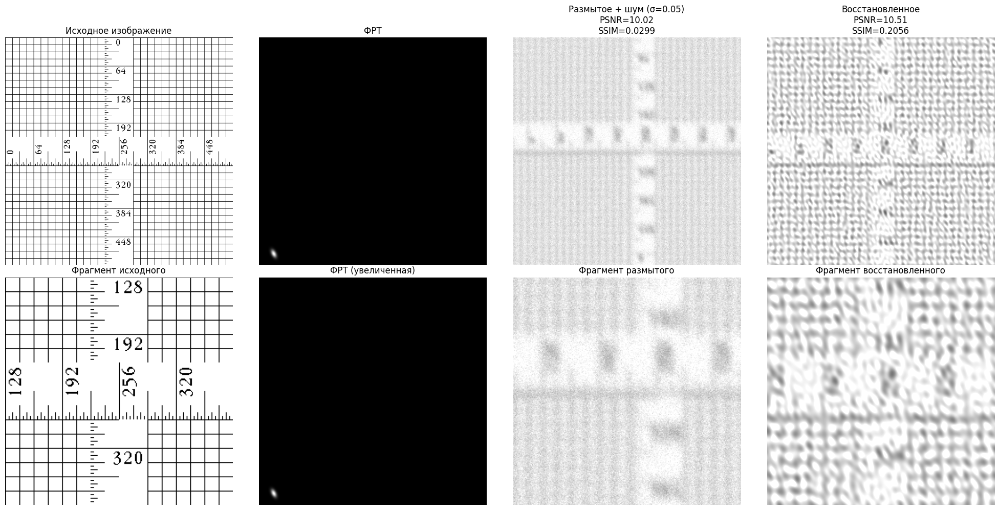


Обработка ruler.512_frt2_noise0.1.pt
Размерности тензоров:
Оригинал: torch.Size([512, 512])
ФРТ: torch.Size([512, 512])
Размытое: torch.Size([512, 512])
Выполнение деконволюции Ричардсона-Люси:
Итерация 5/500
Итерация 10/500
Итерация 15/500
Алгоритм остановлен на итерации 16 из-за достижения заданной точности.


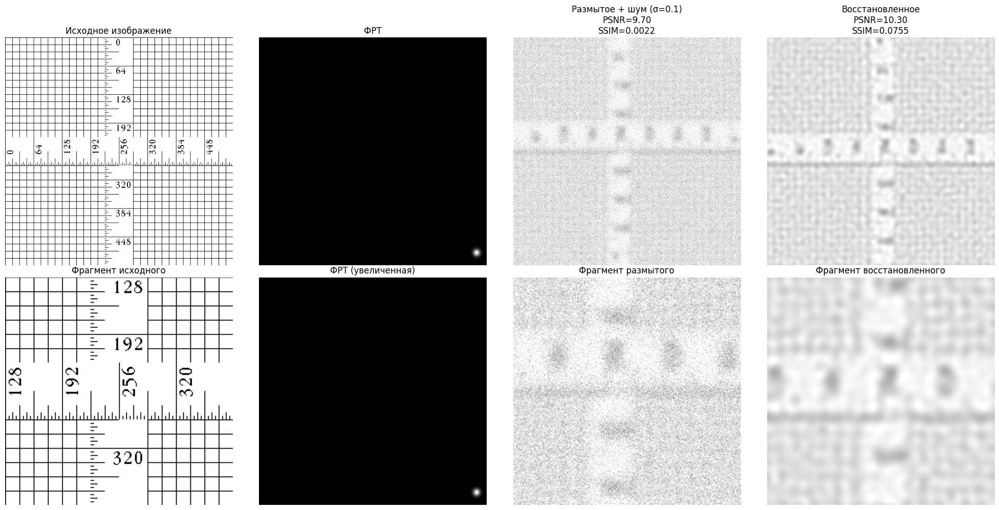


Обработка ruler.512_frt1_noise0.05.pt
Размерности тензоров:
Оригинал: torch.Size([512, 512])
ФРТ: torch.Size([512, 512])
Размытое: torch.Size([512, 512])
Выполнение деконволюции Ричардсона-Люси:
Итерация 5/500
Итерация 10/500
Итерация 15/500
Итерация 20/500
Итерация 25/500
Итерация 30/500
Итерация 35/500
Итерация 40/500
Итерация 45/500
Итерация 50/500
Итерация 55/500
Итерация 60/500
Итерация 65/500
Итерация 70/500
Итерация 75/500
Итерация 80/500
Итерация 85/500
Итерация 90/500
Итерация 95/500
Итерация 100/500
Итерация 105/500
Итерация 110/500
Итерация 115/500
Итерация 120/500
Итерация 125/500
Итерация 130/500
Итерация 135/500
Итерация 140/500
Итерация 145/500
Итерация 150/500
Итерация 155/500
Итерация 160/500
Итерация 165/500
Итерация 170/500
Итерация 175/500
Итерация 180/500
Итерация 185/500
Итерация 190/500
Итерация 195/500
Итерация 200/500
Итерация 205/500
Итерация 210/500
Итерация 215/500
Итерация 220/500
Итерация 225/500
Итерация 230/500
Итерация 235/500
Итерация 240/500
Итерация

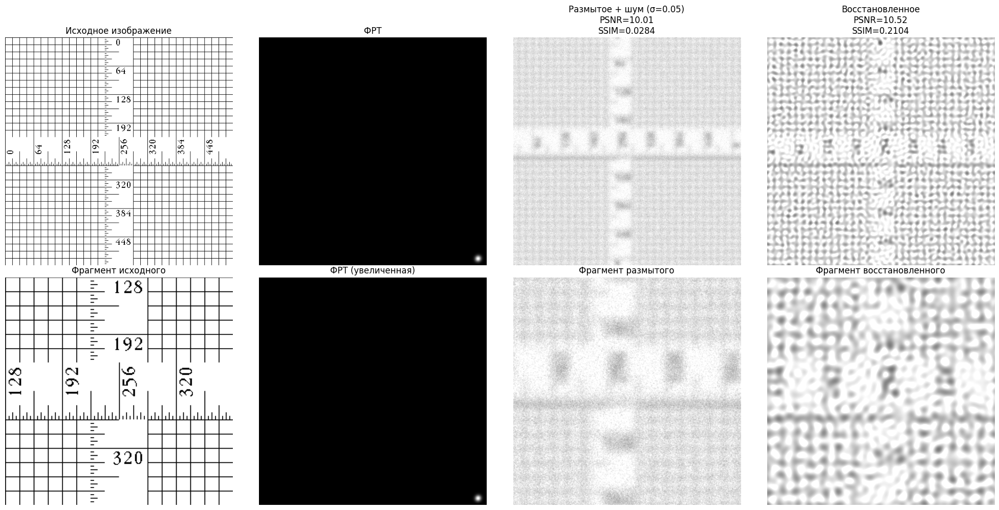


Обработка ruler.512_frt3_noise0.1.pt
Размерности тензоров:
Оригинал: torch.Size([512, 512])
ФРТ: torch.Size([512, 512])
Размытое: torch.Size([512, 512])
Выполнение деконволюции Ричардсона-Люси:
Итерация 5/500
Итерация 10/500
Итерация 15/500
Алгоритм остановлен на итерации 19 из-за достижения заданной точности.


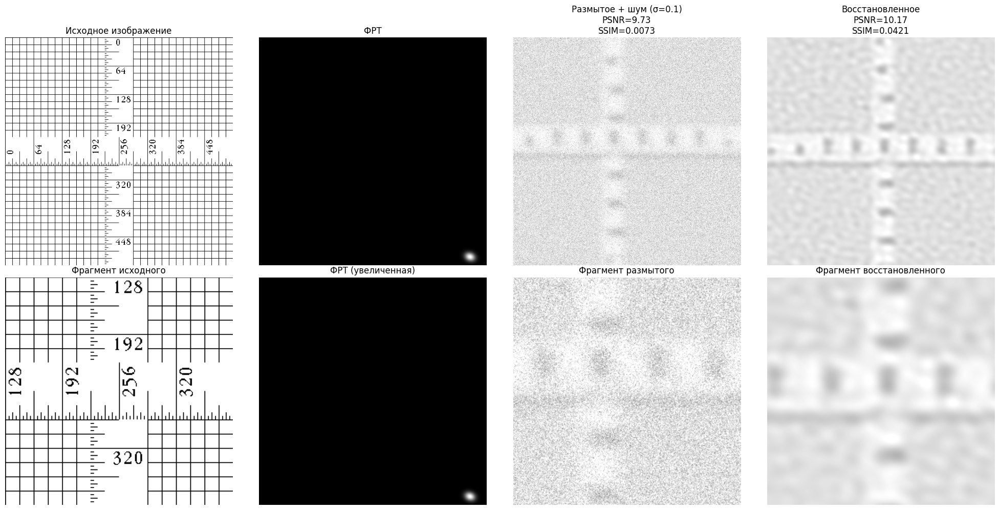


Обработка ruler.512_frt1_noise0.01.pt
Размерности тензоров:
Оригинал: torch.Size([512, 512])
ФРТ: torch.Size([512, 512])
Размытое: torch.Size([512, 512])
Выполнение деконволюции Ричардсона-Люси:
Итерация 5/500
Итерация 10/500
Итерация 15/500
Итерация 20/500
Итерация 25/500
Итерация 30/500
Итерация 35/500
Итерация 40/500
Итерация 45/500
Итерация 50/500
Итерация 55/500
Итерация 60/500
Итерация 65/500
Итерация 70/500
Итерация 75/500
Итерация 80/500
Итерация 85/500
Итерация 90/500
Итерация 95/500
Итерация 100/500
Итерация 105/500
Итерация 110/500
Итерация 115/500
Итерация 120/500
Итерация 125/500
Итерация 130/500
Итерация 135/500
Итерация 140/500
Итерация 145/500
Итерация 150/500
Итерация 155/500
Итерация 160/500
Итерация 165/500
Итерация 170/500
Итерация 175/500
Итерация 180/500
Итерация 185/500
Итерация 190/500
Итерация 195/500
Итерация 200/500
Итерация 205/500
Итерация 210/500
Итерация 215/500
Итерация 220/500
Итерация 225/500
Итерация 230/500
Итерация 235/500
Итерация 240/500
Итерация

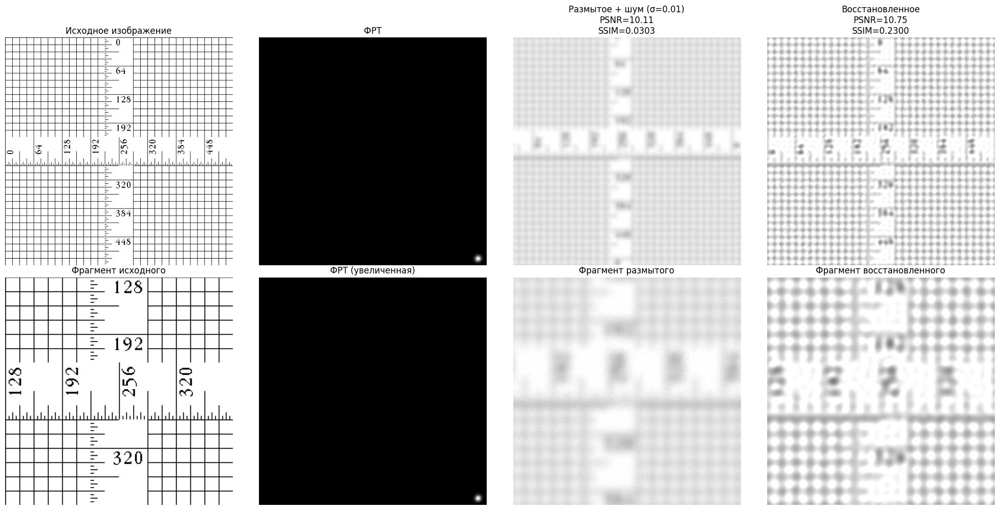


Обработка ruler.512_frt1_noise0.1.pt
Размерности тензоров:
Оригинал: torch.Size([512, 512])
ФРТ: torch.Size([512, 512])
Размытое: torch.Size([512, 512])
Выполнение деконволюции Ричардсона-Люси:
Итерация 5/500
Итерация 10/500
Итерация 15/500
Итерация 20/500
Итерация 25/500
Итерация 30/500
Итерация 35/500
Итерация 40/500
Итерация 45/500
Итерация 50/500
Итерация 55/500
Итерация 60/500
Итерация 65/500
Итерация 70/500
Итерация 75/500
Итерация 80/500
Итерация 85/500
Итерация 90/500
Итерация 95/500
Итерация 100/500
Итерация 105/500
Итерация 110/500
Итерация 115/500
Итерация 120/500
Итерация 125/500
Итерация 130/500
Итерация 135/500
Итерация 140/500
Итерация 145/500
Итерация 150/500
Итерация 155/500
Итерация 160/500
Итерация 165/500
Итерация 170/500
Итерация 175/500
Итерация 180/500
Итерация 185/500
Итерация 190/500
Итерация 195/500
Итерация 200/500
Итерация 205/500
Итерация 210/500
Итерация 215/500
Итерация 220/500
Итерация 225/500
Итерация 230/500
Итерация 235/500
Итерация 240/500
Итерация 

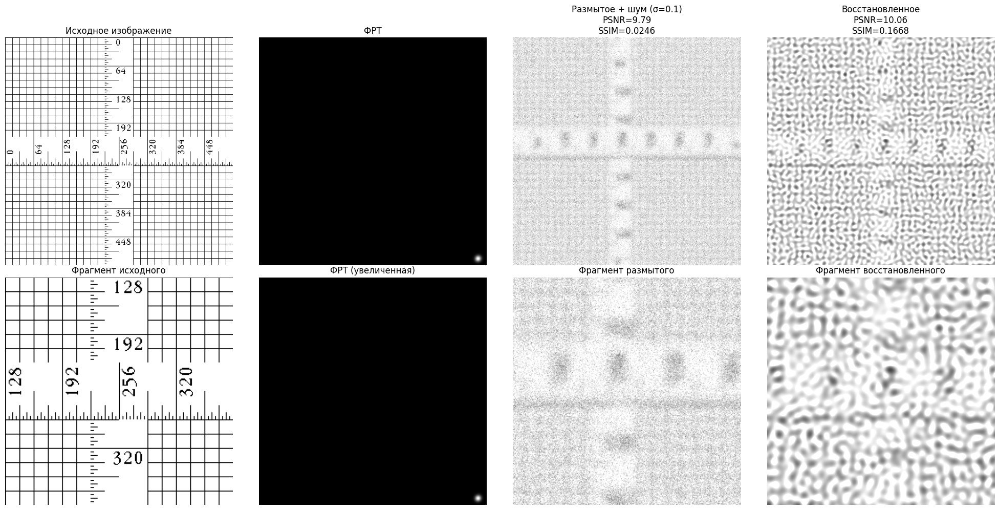


Обработка ruler.512_frt2_noise0.05.pt
Размерности тензоров:
Оригинал: torch.Size([512, 512])
ФРТ: torch.Size([512, 512])
Размытое: torch.Size([512, 512])
Выполнение деконволюции Ричардсона-Люси:
Итерация 5/500
Итерация 10/500
Итерация 15/500
Итерация 20/500
Итерация 25/500
Итерация 30/500
Итерация 35/500
Итерация 40/500
Итерация 45/500
Итерация 50/500
Итерация 55/500
Итерация 60/500
Итерация 65/500
Итерация 70/500
Итерация 75/500
Итерация 80/500
Итерация 85/500
Итерация 90/500
Итерация 95/500
Итерация 100/500
Итерация 105/500
Итерация 110/500
Итерация 115/500
Итерация 120/500
Итерация 125/500
Итерация 130/500
Итерация 135/500
Итерация 140/500
Итерация 145/500
Итерация 150/500
Итерация 155/500
Итерация 160/500
Итерация 165/500
Итерация 170/500
Итерация 175/500
Итерация 180/500
Итерация 185/500
Итерация 190/500
Итерация 195/500
Итерация 200/500
Итерация 205/500
Итерация 210/500
Итерация 215/500
Итерация 220/500
Итерация 225/500
Итерация 230/500
Итерация 235/500
Итерация 240/500
Итерация

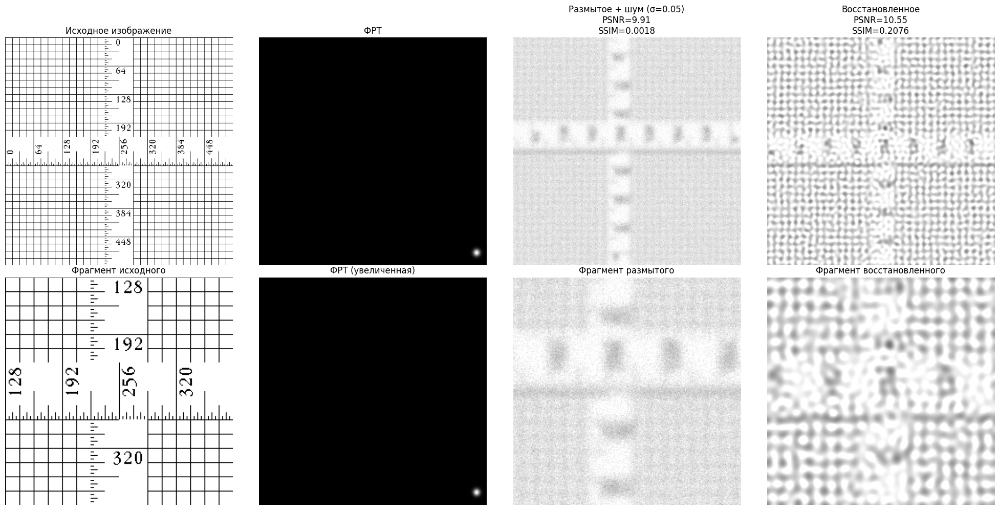


Обработка завершена!
Результаты сохранены в директории: результаты_восстановления_4
Метрики сохранены в файле: результаты_восстановления_4/metrics.txt


In [61]:
import torch
import numpy as np
import matplotlib.pyplot as plt
import os
from olimp.processing import fft_conv

def psnr(original, compared, data_range=1.0):
    """Расчет PSNR"""
    mse = np.mean((original - compared) ** 2)
    if mse == 0:
        return float('inf')
    return 20 * np.log10(data_range) - 10 * np.log10(mse)

def ssim(original, compared, data_range=1.0):
    """Упрощенный расчет SSIM"""
    C1 = (0.01 * data_range) ** 2
    C2 = (0.03 * data_range) ** 2

    mu1 = original.mean()
    mu2 = compared.mean()
    
    sigma1_sq = np.var(original)
    sigma2_sq = np.var(compared)
    sigma12 = np.cov(original.flatten(), compared.flatten())[0, 1]

    numerator = (2 * mu1 * mu2 + C1) * (2 * sigma12 + C2)
    denominator = (mu1**2 + mu2**2 + C1) * (sigma1_sq + sigma2_sq + C2)
    
    return numerator / denominator

def richardson_lucy(image, psf, num_iterations, tolerance=1e-8):
    """Реализация алгоритма деконволюции Ричардсона-Люси"""
    # Инициализация оценки изображения
    estimate = torch.ones_like(image)
    psf_flip = torch.flip(psf, dims=[0, 1])
    error_history = []
    print("Выполнение деконволюции Ричардсона-Люси:")
    for i in range(num_iterations):
        if (i + 1) % 5 == 0:
            print(f"Итерация {i + 1}/{num_iterations}")
        # Прямая свертка текущей оценки
        conv = fft_conv(estimate, psf)
        # Относительная ошибка
        relative_blur = image / (conv + 1e-10)
        # Обратная свертка ошибки
        error_estimate = fft_conv(relative_blur, psf_flip)
        # Обновление оценки
        new_estimate = estimate * error_estimate
        # Ограничиваем значения в диапазоне [0, 1]
        estimate = torch.clamp(estimate, 0, 1)
        error = torch.mean((new_estimate - estimate)**2)  # MSE между новой и старой оценкой
        error_history.append(error.item()) # Сохраняем значение ошибки (преобразуем в Python number)

        # Проверка критерия остановки
        if i > 0 and abs(error_history[i] - error_history[i-1]) < tolerance:
            print(f"Алгоритм остановлен на итерации {i+1} из-за достижения заданной точности.")
            return new_estimate

        # Обновление оценки
        estimate = new_estimate
    
    print(f"Алгоритм завершен после {i} итераций.")
    
    return estimate

def calculate_metrics(original, compared):
    """Расчет PSNR и SSIM"""
    # Преобразуем тензоры в numpy массивы
    if torch.is_tensor(original):
        original = original.cpu().numpy()
    if torch.is_tensor(compared):
        compared = compared.cpu().numpy()
    
    # Убеждаемся, что у нас 2D массивы
    if original.ndim > 2:
        original = original.squeeze()
    if compared.ndim > 2:
        compared = compared.squeeze()
    
    # Нормализуем значения в диапазон [0, 1]
    original = np.clip(original, 0, 1)
    compared = np.clip(compared, 0, 1)
    
    return psnr(original, compared, data_range=1.0), ssim(original, compared, data_range=1.0)

def plot_and_save_results(original, psf, blurred_noisy, restored, noise_std, psnr_blurred, ssim_blurred, 
                         psnr_restored, ssim_restored, output_path):
    """Визуализация и сохранение результатов"""
    # Преобразуем тензоры в numpy массивы
    if torch.is_tensor(original):
        original = original.squeeze().cpu().numpy()
    if torch.is_tensor(psf):
        psf = psf.squeeze().cpu().numpy()
    if torch.is_tensor(blurred_noisy):
        blurred_noisy = blurred_noisy.squeeze().cpu().numpy()
    if torch.is_tensor(restored):
        restored = restored.squeeze().cpu().numpy()

    plt.figure(figsize=(20, 10))
    
    # Первый ряд
    plt.subplot(241)
    plt.imshow(original, cmap='gray', vmin=0, vmax=1)
    plt.title('Исходное изображение')
    plt.axis('off')
    
    plt.subplot(242)
    plt.imshow(psf, cmap='gray')
    plt.title('ФРТ')
    plt.axis('off')
    
    plt.subplot(243)
    plt.imshow(blurred_noisy, cmap='gray', vmin=0, vmax=1)
    plt.title(f'Размытое + шум (σ={noise_std})\nPSNR={psnr_blurred:.2f}\nSSIM={ssim_blurred:.4f}')
    plt.axis('off')
    
    plt.subplot(244)
    plt.imshow(restored, cmap='gray', vmin=0, vmax=1)
    plt.title(f'Восстановленное\nPSNR={psnr_restored:.2f}\nSSIM={ssim_restored:.4f}')
    plt.axis('off')
    
    # Второй ряд (увеличенные фрагменты)
    height, width = original.shape
    crop_h, crop_w = height//4, width//4
    crop_size_h, crop_size_w = height//2, width//2
    
    plt.subplot(245)
    plt.imshow(original[crop_h:crop_h+crop_size_h, crop_w:crop_w+crop_size_w], 
               cmap='gray', vmin=0, vmax=1)
    plt.title('Фрагмент исходного')
    plt.axis('off')
    
    plt.subplot(246)
    plt.imshow(psf, cmap='gray')
    plt.title('ФРТ (увеличенная)')
    plt.axis('off')
    
    plt.subplot(247)
    plt.imshow(blurred_noisy[crop_h:crop_h+crop_size_h, crop_w:crop_w+crop_size_w], 
               cmap='gray', vmin=0, vmax=1)
    plt.title('Фрагмент размытого')
    plt.axis('off')
    
    plt.subplot(248)
    plt.imshow(restored[crop_h:crop_h+crop_size_h, crop_w:crop_w+crop_size_w], 
               cmap='gray', vmin=0, vmax=1)
    plt.title('Фрагмент восстановленного')
    plt.axis('off')
    
    plt.tight_layout()
    plt.savefig(output_path, bbox_inches='tight', dpi=150)
    plt.show()
    plt.close()

# Основной код
output_dir = "выходные_данные_4"
results_dir = "результаты_восстановления_4"
os.makedirs(results_dir, exist_ok=True)

# Создаем файл для метрик
metrics_file = os.path.join(results_dir, "metrics.txt")
with open(metrics_file, "w") as f:
    f.write("Файл\tШум\tPSNR(размытое)\tSSIM(размытое)\tPSNR(восст.)\tSSIM(восст.)\tdelta_ssim\tdelta_psnr\n")

# Обработка всех файлов
for file in os.listdir(output_dir):
    if file.endswith(".pt"):
        print(f"\nОбработка {file}")
        try:
            # Загружаем данные как словарь
            data_dict = torch.load(os.path.join(output_dir, file))
            
            # Получаем данные из словаря
            original = data_dict['original']
            psf = data_dict['psf']
            blurred_noisy = data_dict['blurred_noisy']
            noise_std = data_dict['noise_std']
            
            print(f"Размерности тензоров:")
            print(f"Оригинал: {original.shape}")
            print(f"ФРТ: {psf.shape}")
            print(f"Размытое: {blurred_noisy.shape}")
            
            # Применяем деконволюцию
            restored = richardson_lucy(blurred_noisy, psf, num_iterations=500)
            
            # Рассчитываем метрики
            psnr_blurred, ssim_blurred = calculate_metrics(original, blurred_noisy)
            psnr_restored, ssim_restored = calculate_metrics(original, restored)
            delta_psnr = psnr_restored - psnr_blurred
            delta_ssim = ssim_restored - ssim_blurred
            
            # Записываем метрики
            with open(metrics_file, "a") as f:
                f.write(f"{file}\t{noise_std}\t{psnr_blurred:.2f}\t{ssim_blurred:.4f}\t"
                       f"{psnr_restored:.2f}\t{ssim_restored:.2f}\t{delta_ssim:.2f}\t{delta_psnr:.2f}\n")
            
            # Визуализируем результаты
            output_path = os.path.join(results_dir, f"restored_{file[:-3]}.png")
            plot_and_save_results(
                original, psf, blurred_noisy, restored,
                noise_std, psnr_blurred, ssim_blurred,
                psnr_restored, ssim_restored,
                output_path
            )
            
        except Exception as e:
            print(f"Ошибка при обработке файла {file}: {str(e)}")
            import traceback
            traceback.print_exc()
            continue

print("\nОбработка завершена!")
print(f"Результаты сохранены в директории: {results_dir}")
print(f"Метрики сохранены в файле: {metrics_file}")